### Import necessary headers

In [1]:
%matplotlib inline

import numpy as np
import scipy.io as sio
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split

import keras
from keras.models import load_model
from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, MaxPooling2D
from IPython.display import SVG
from keras.utils.visualize_util import model_to_dot


Using Theano backend.
Using gpu device 0: Quadro M1000M (CNMeM is disabled, cuDNN 5105)
/home/abhishek/workspace/94.15/venv/local/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


### Define variables

In [2]:
high_traffic_data  = '7high.mat'
medium_traffic_data = '7med.mat'
low_traffic_data = '7low.mat'


batch_size = 10
nb_classes = 3
# high = 2
# medium = 1
# low = 0
nb_epoch = 15

### Load data
#### (Keep 7high.mat,7med.mat and 7low.mat in same directory as this notebook)

In [3]:
print 'Shape of image :\t166*166'


X_high = sio.loadmat(high_traffic_data)
X_high = X_high['X']
y_high = np.ones(X_high.shape[0], dtype=np.int)
y_high = 2 * y_high 
print 'Number of high traffic images :\t\t',X_high.shape[0]

X_medium = sio.loadmat(medium_traffic_data)
X_medium = X_medium['X']
y_medium = np.ones(X_medium.shape[0], dtype=np.int)
print 'Number of medium traffic images :\t',X_medium.shape[0]

X_low = sio.loadmat(low_traffic_data)
X_low = X_low['X']
y_low = np.zeros(X_low.shape[0], dtype=np.int)
print 'Number of low traffic images :\t\t',X_low.shape[0]

X = np.append(X_high, X_medium, axis=0)
X = np.append(X, X_low, axis=0)
y = np.append(y_high, y_medium, axis=0)
y = np.append(y, y_low, axis=0)

X, y = shuffle(X, y, random_state=23)


print 'Size of X :\t\t',X.shape
print 'Size of y :\t\t',y.shape


Shape of image :	166*166
Number of high traffic images :		709
Number of medium traffic images :	988
Number of low traffic images :		552
Size of X :		(2249, 27556)
Size of y :		(2249,)


### Reshape and divide data into test/train/validation sets

After reshaping

Shape of X :		(2249, 1, 166, 166)
Shape of y :		(2249, 3)


After dividing data

Shape of X_train :	(1506, 1, 166, 166)
Shape of y_train :	(1506, 3)
Shape of X_test :	(743, 1, 166, 166)
Shape of y_test :	(743, 3)


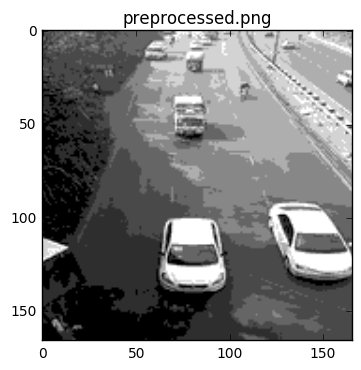

In [4]:
X_ = np.asarray([np.reshape(item, (1,166, 166)) for item in X])
y_ = np_utils.to_categorical(y, nb_classes)

print 'After reshaping\n'
print 'Shape of X :\t\t', X_.shape
print 'Shape of y :\t\t', y_.shape

X_train, X_test, y_train, y_test = train_test_split(X_, y_, test_size=0.33, random_state=42)

print '\n\nAfter dividing data\n'
print 'Shape of X_train :\t', X_train.shape
print 'Shape of y_train :\t', y_train.shape
print 'Shape of X_test :\t', X_test.shape
print 'Shape of y_test :\t', y_test.shape


temp = X_test[3]
temp = np.reshape(temp,(166,166))
temp = np.rot90(temp,3)
plt.imshow(np.reshape(temp,(166,166)), cmap='gray')
plt.title("preprocessed.png")
plt.show()

### Model

In [5]:
model=Sequential()
model.add(Convolution2D(5,5,5 ,subsample=(1,1),border_mode='same' ,input_shape=(1,166,166),dim_ordering="th"))
model.add(MaxPooling2D(pool_size=(2,2),dim_ordering="th"))
act1 = (Activation('relu'))
model.add(act1)

model.add(Convolution2D(10 ,6,6 ,subsample=(1,1),border_mode='same',dim_ordering="th" ))#,input_shape=(5,81,81)))
model.add(MaxPooling2D(pool_size=(2,2),dim_ordering="th"))
act2 = (Activation('relu'))
model.add(act2)

model.add(Convolution2D(15 ,5,5 ,subsample=(1,1),border_mode='same',dim_ordering="th" ))#,input_shape=(10,38,38)))
model.add(MaxPooling2D(pool_size=(2,2),dim_ordering="th"))
act3 = (Activation('relu'))
model.add(act3)

model.add(Convolution2D(20,4,4 ,subsample=(1,1),border_mode='same',dim_ordering="th" ))#,input_shape=(15,17,17)))
model.add(MaxPooling2D(pool_size=(2,2),dim_ordering="th"))
act4 = (Activation('relu'))
model.add(act4)

model.add(Convolution2D(40,2,2 ,subsample=(1,1),border_mode='same',dim_ordering="th" ))#,input_shape=(40,2,2)))
model.add(MaxPooling2D(pool_size=(2,2),dim_ordering="th"))
act5 = (Activation('relu'))
model.add(act5)


model.add(Flatten())
model.add(Dense(360))
model.add(Activation('relu'))
model.add(Dropout(0.5))

model.add(Dense(3))
model.add(Activation('softmax'))

### Model summary

In [6]:
model.summary()


____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
convolution2d_1 (Convolution2D)  (None, 5, 166, 166)   130         convolution2d_input_1[0][0]      
____________________________________________________________________________________________________
maxpooling2d_1 (MaxPooling2D)    (None, 5, 83, 83)     0           convolution2d_1[0][0]            
____________________________________________________________________________________________________
activation_1 (Activation)        (None, 5, 83, 83)     0           maxpooling2d_1[0][0]             
____________________________________________________________________________________________________
convolution2d_2 (Convolution2D)  (None, 10, 83, 83)    1810        activation_1[0][0]               
___________________________________________________________________________________________

### Model diagram

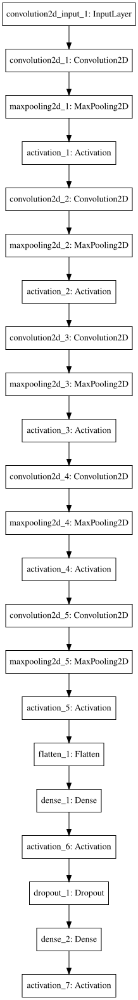

In [8]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))

### Define class to obtain intermediate results

In [9]:
class LossHistory(keras.callbacks.Callback):

    def on_train_begin(self, logs={}):
        self.losses = []
        self.accu = []
        self.valid_losses = []
        self.valid_accu = []

    def on_batch_end(self, batch, logs={}):
    	# print logs.keys()
        self.losses.append(logs.get('loss'))
        self.accu.append(logs.get('acc'))
        self.valid_losses.append(logs.get('val_loss'))
        self.valid_accu.append(logs.get('val_acc'))

### Train model and save
#### (Takes < 2minutes on a Quadro M1000M)

In [10]:
history = LossHistory()

model.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
model.fit(X_train, y_train, batch_size=batch_size, nb_epoch=nb_epoch, verbose=1, validation_split=0.2, shuffle=True,callbacks=[history])
model.save('my_model.h5')

Train on 1204 samples, validate on 302 samples
Epoch 1/15
1204/1204 [==============================] - 3s - loss: 0.9735 - acc: 0.5266 - val_loss: 0.7356 - val_acc: 0.6954

### Or load model

In [26]:
model = load_model('my_model.h5')

### Check accuracy on test set

In [12]:
y_pred = model.predict(X_test, verbose=1)
y_pred = np.argmax(y_pred,axis=1)
y_act = np.argmax(y_test,axis=1)
correct = np.sum(np.equal(y_act,y_pred))
correct =  float(correct)
print "\n\nTest set accuracy : ",correct/X_test.shape[0]


736/743 [============================>.] - ETA: 0s

### Plot graphs

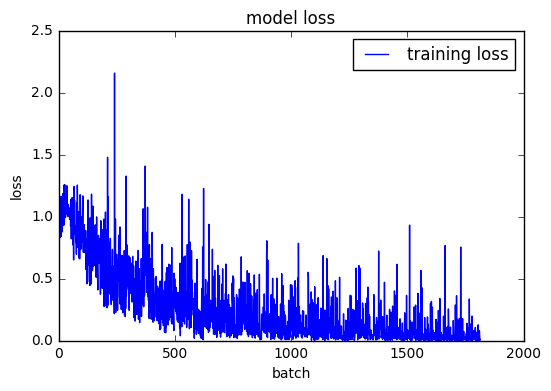

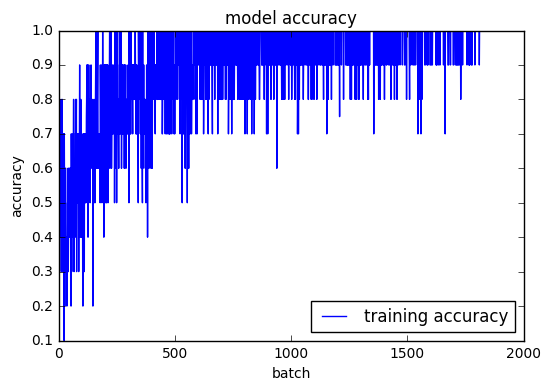

In [13]:
plt.plot(history.losses)
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('batch')
plt.legend(['training loss'], loc='upper right')
# plt.savefig("m1.png")
plt.show()


plt.plot(history.accu)
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('batch')
plt.legend(['training accuracy'	], loc='lower right')
# plt.savefig("m3.png")
plt.show()


### Plot weights

(5, 1, 5, 5)


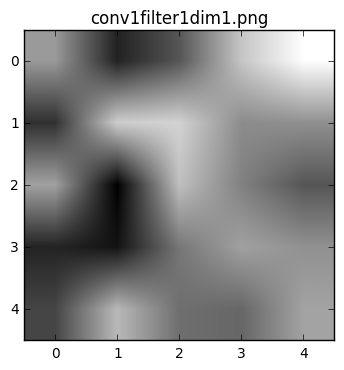

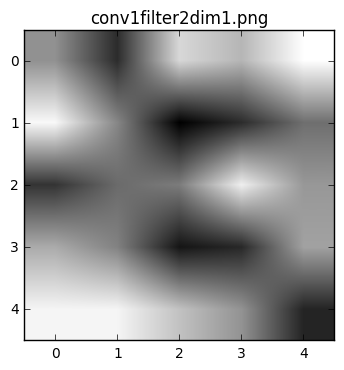

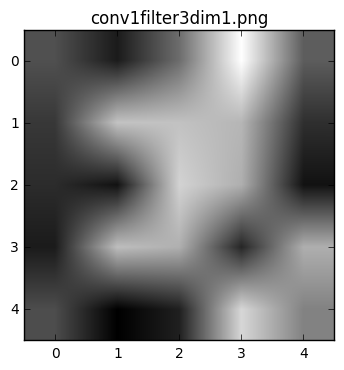

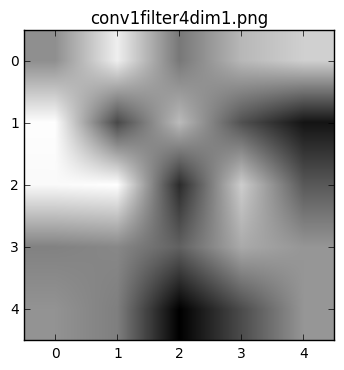

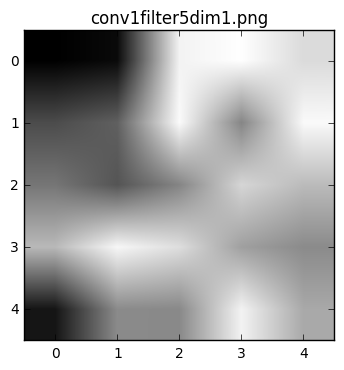

(10, 5, 6, 6)


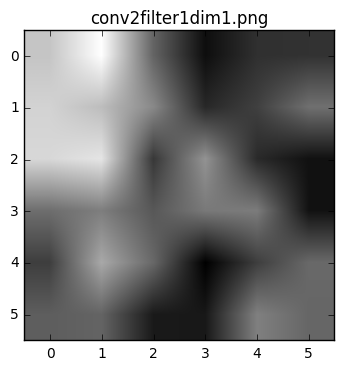

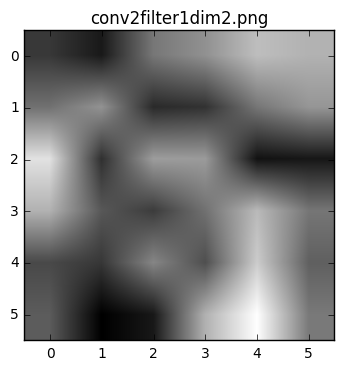

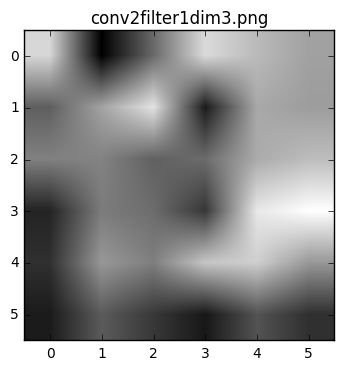

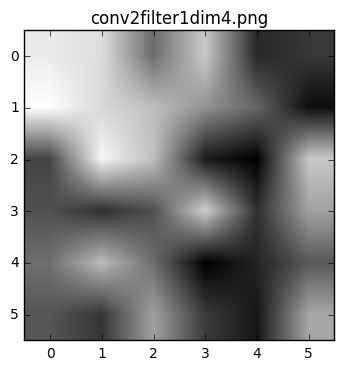

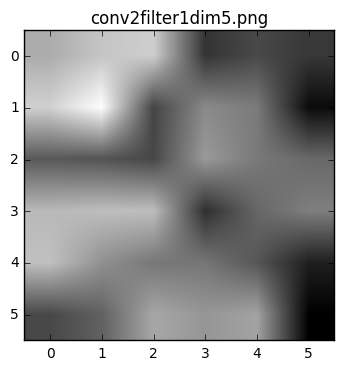

...

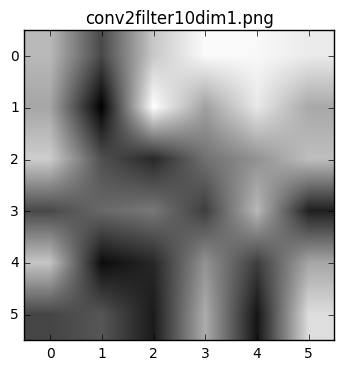

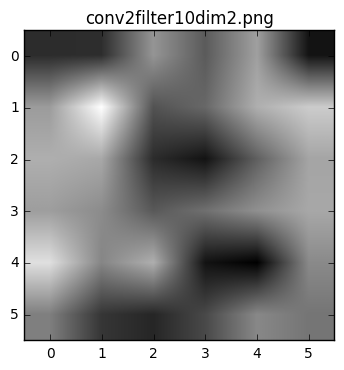

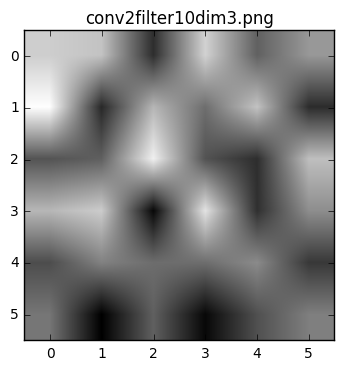

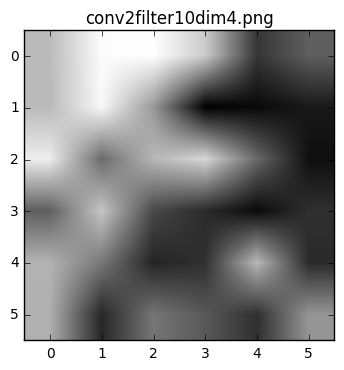

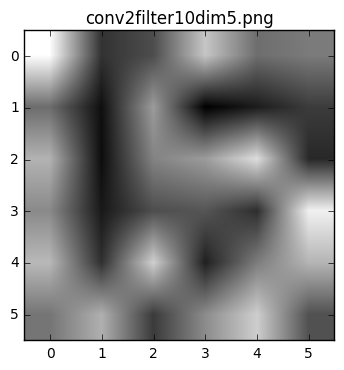

(15, 10, 5, 5)


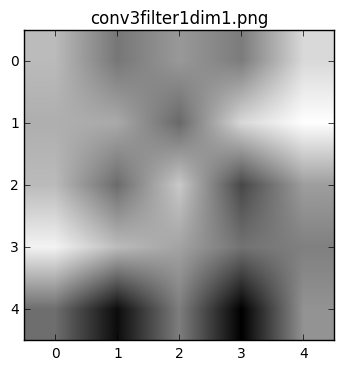

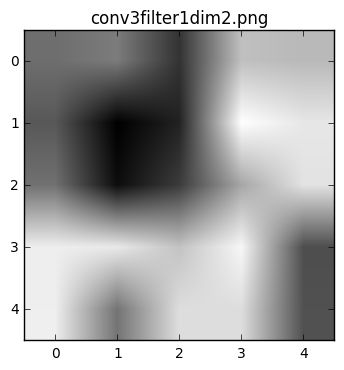

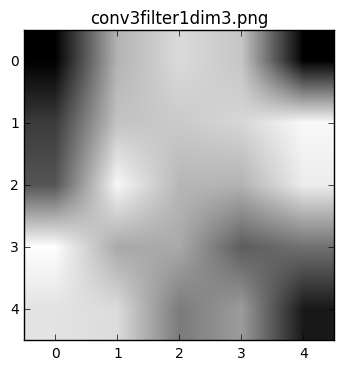

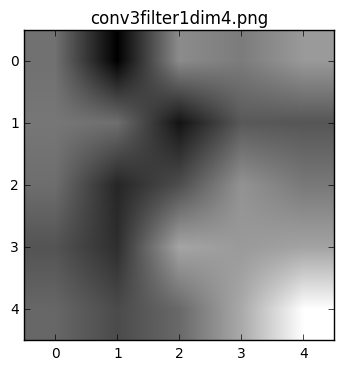

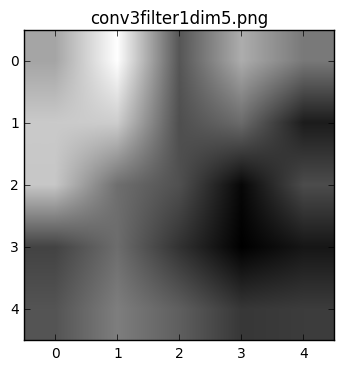

...

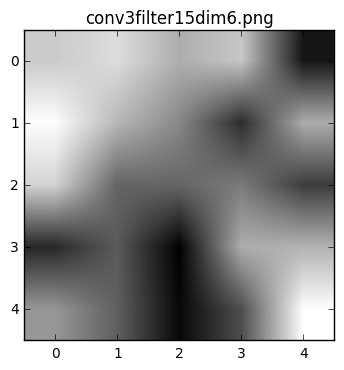

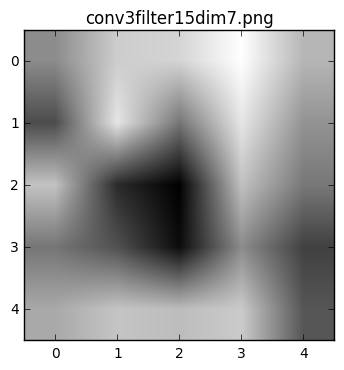

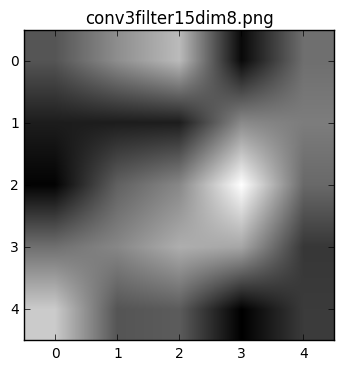

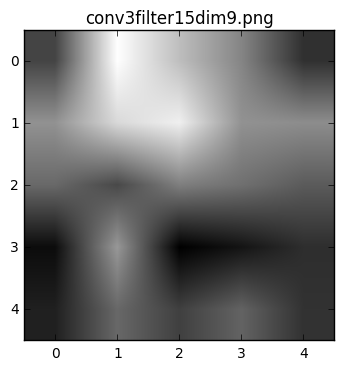

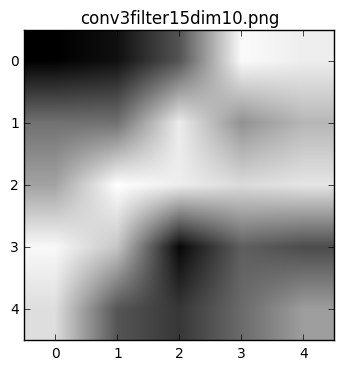

(20, 15, 4, 4)


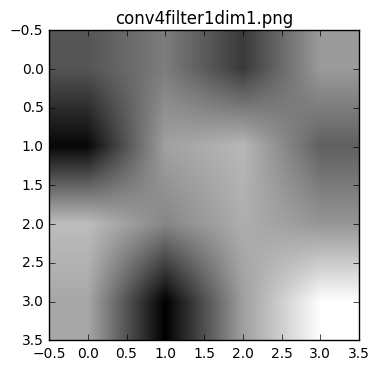

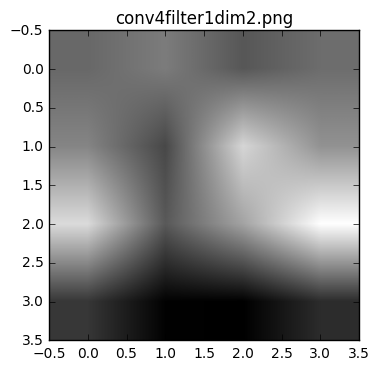

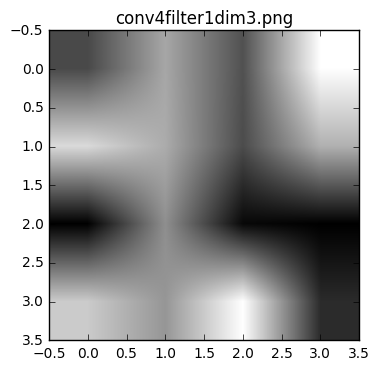

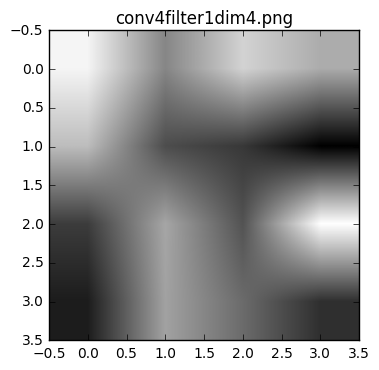

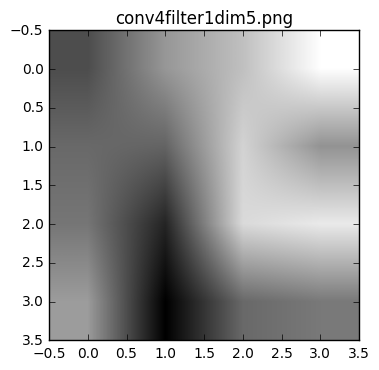

...

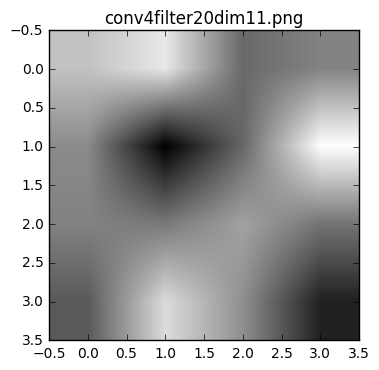

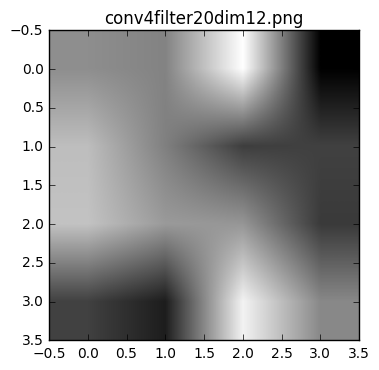

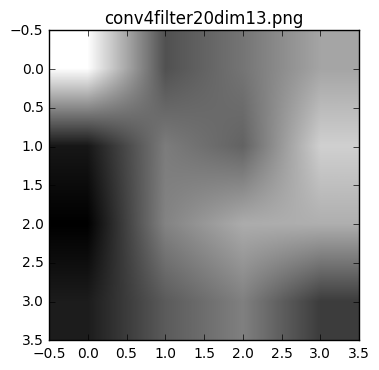

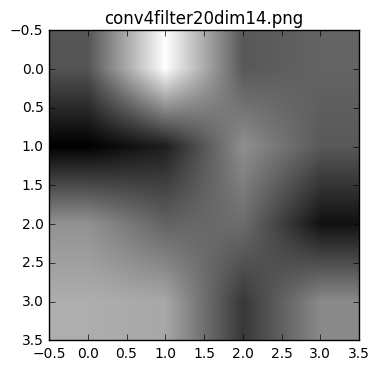

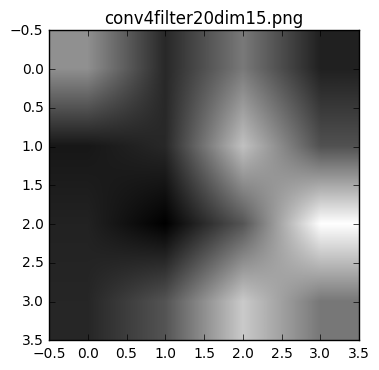

(40, 20, 2, 2)


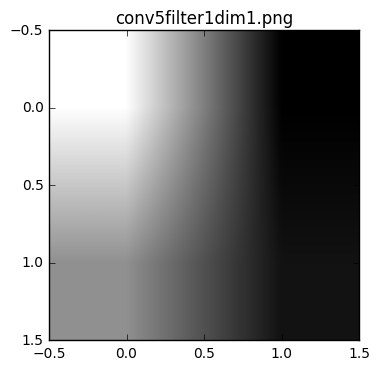

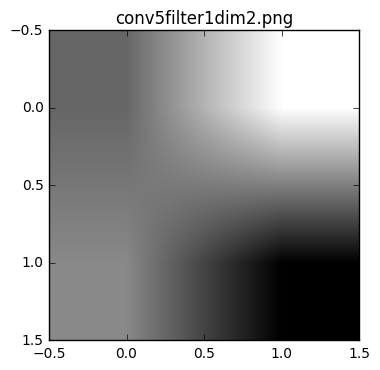

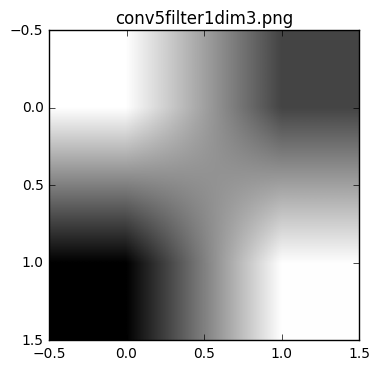

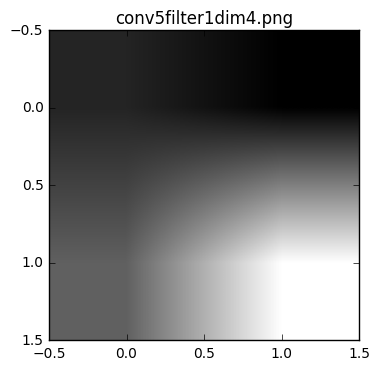

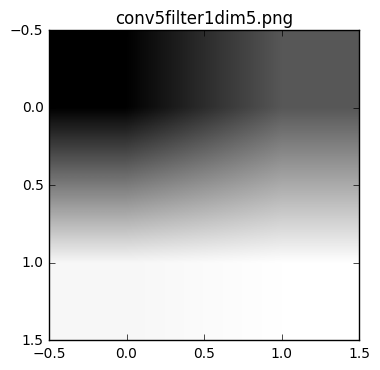

...

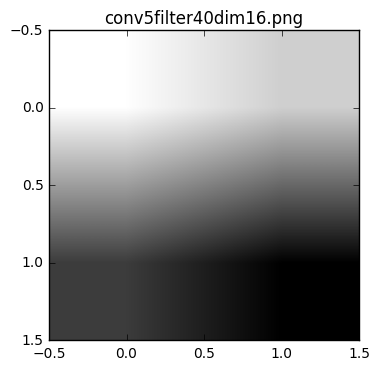

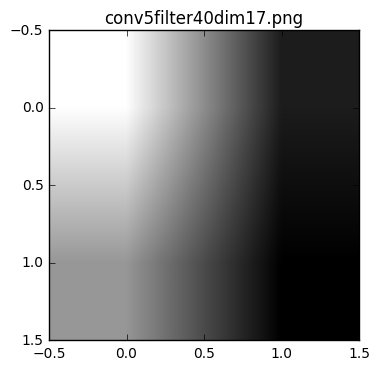

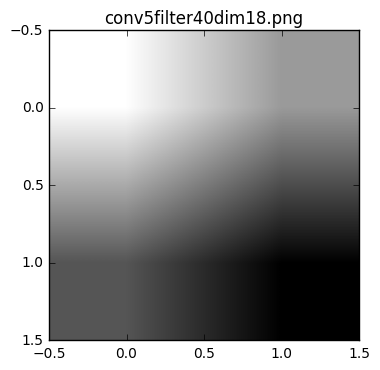

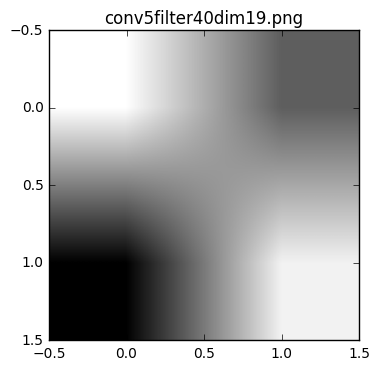

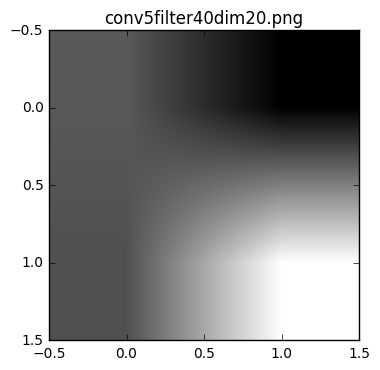

In [14]:
weights1 = model.layers[0].get_weights()
weights1 = np.asarray(weights1[0])
print weights1.shape
for i in range(weights1.shape[0]):
    plt.imshow(np.reshape(weights1[i],(weights1.shape[2],weights1.shape[3])), cmap='gray')
    plt.title("conv1filter"+str(i+1)+"dim1.png")
    plt.show()
    
weights1 = model.layers[3].get_weights()
weights1 = np.asarray(weights1[0])
print weights1.shape
for i in range(weights1.shape[0]):
    for j in range(weights1.shape[1]):
        plt.imshow(np.reshape(weights1[i][j],(weights1.shape[2],weights1.shape[3])), cmap='gray')
        plt.title("conv2filter"+str(i+1)+"dim"+str(j+1)+".png")
        plt.show()

weights1 = model.layers[6].get_weights()
weights1 = np.asarray(weights1[0])
print weights1.shape

for i in range(weights1.shape[0]):
    for j in range(weights1.shape[1]):
        plt.imshow(np.reshape(weights1[i][j],(weights1.shape[2],weights1.shape[3])), cmap='gray')
        plt.title("conv3filter"+str(i+1)+"dim"+str(j+1)+".png")
        plt.show()

weights1 = model.layers[9].get_weights()
weights1 = np.asarray(weights1[0])
print weights1.shape

for i in range(weights1.shape[0]):
    for j in range(weights1.shape[1]):
        plt.imshow(np.reshape(weights1[i][j],(weights1.shape[2],weights1.shape[3])), cmap='gray')
        plt.title("conv4filter"+str(i+1)+"dim"+str(j+1)+".png")
        plt.show()

weights1 = model.layers[12].get_weights()
weights1 = np.asarray(weights1[0])
print weights1.shape

for i in range(weights1.shape[0]):
    for j in range(weights1.shape[1]):
        plt.imshow(np.reshape(weights1[i][j],(weights1.shape[2],weights1.shape[3])), cmap='gray')
        plt.title("conv5filter"+str(i+1)+"dim"+str(j+1)+".png")
        plt.show()



### Show activations

[keras_learning_phase, convolution2d_input_1]
('C1 shape : ', (5, 83, 83))
('C2 shape : ', (10, 41, 41))
('C3 shape : ', (15, 20, 20))
('C4 shape : ', (20, 10, 10))
('C5 shape : ', (40, 5, 5))


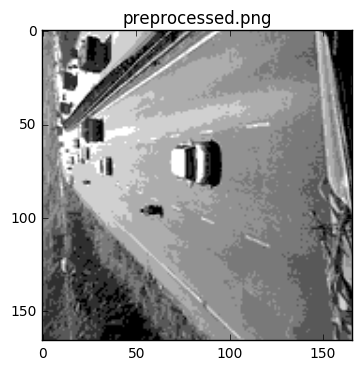

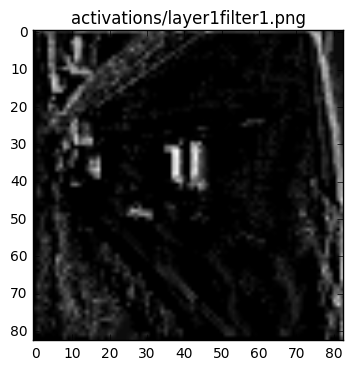

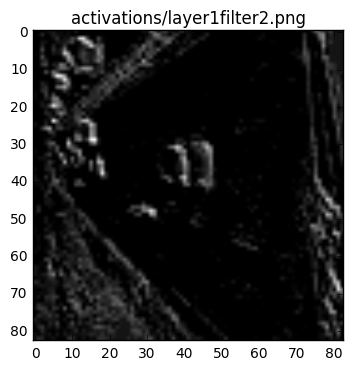

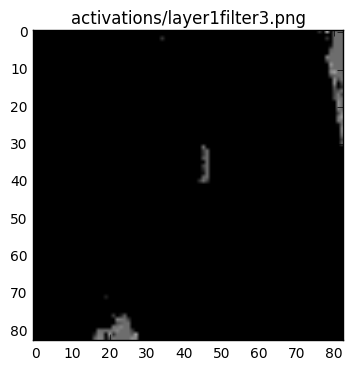

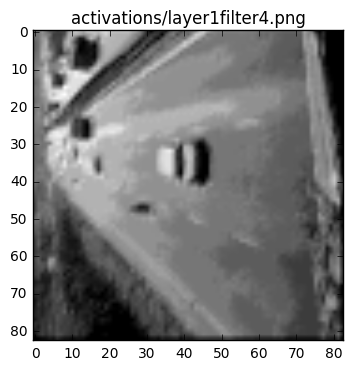

...

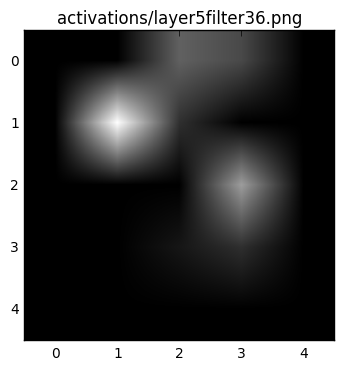

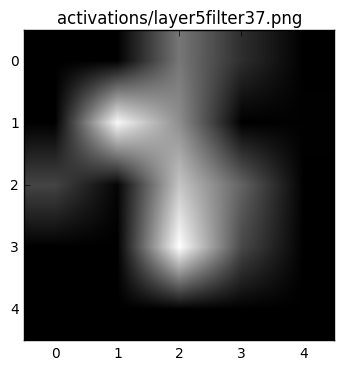

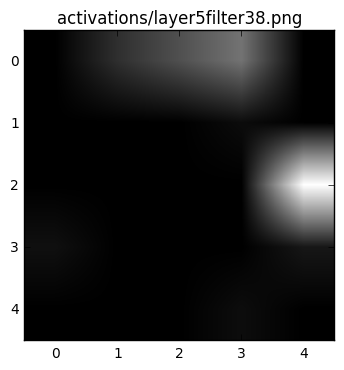

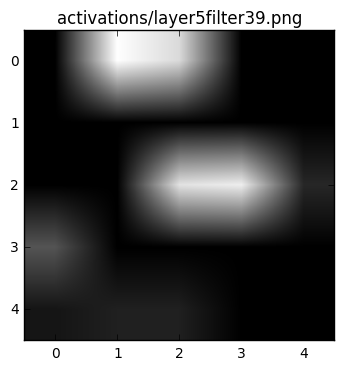

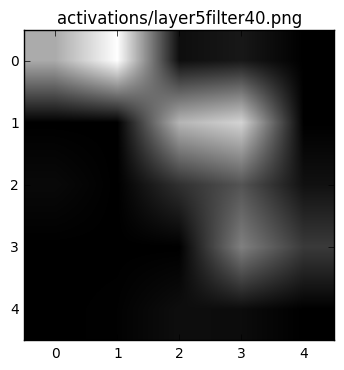

In [15]:
from keras import backend as K
K.set_image_dim_ordering('th')

inputs = [K.learning_phase()] + model.inputs
print inputs
_convout1_f = K.function(inputs, [act1.output])
_convout2_f = K.function(inputs, [act2.output])
_convout3_f = K.function(inputs, [act3.output])
_convout4_f = K.function(inputs, [act4.output])
_convout5_f = K.function(inputs, [act5.output])


def convout1_f(X):
    return _convout1_f([0] + [X])
def convout2_f(X):
    return _convout2_f([0] + [X])
def convout3_f(X):
    return _convout3_f([0] + [X])
def convout4_f(X):
    return _convout4_f([0] + [X])
def convout5_f(X):
    return _convout5_f([0] + [X])

C1 = convout1_f(X_test[0:1])
C1= np.squeeze(C1)
print("C1 shape : ", C1.shape)

C2 = convout2_f(X_test[0:1])
C2= np.squeeze(C2)
print("C2 shape : ", C2.shape)

C3 = convout3_f(X_test[0:1])
C3= np.squeeze(C3)
print("C3 shape : ", C3.shape)

C4 = convout4_f(X_test[0:1])
C4= np.squeeze(C4)
print("C4 shape : ", C4.shape)

C5 = convout5_f(X_test[0:1])
C5= np.squeeze(C5)
print("C5 shape : ", C5.shape)

plt.imshow(np.reshape(X_test[0],(166,166)), cmap='gray')
plt.title("preprocessed.png")
plt.show()


for i in range(C1.shape[0]):
    plt.imshow(np.reshape(C1[i],(C1.shape[1],C1.shape[1])), cmap='gray')
    plt.title("activations/layer1filter"+str(i+1)+".png")
    plt.show()

for i in range(C2.shape[0]):
    plt.imshow(np.reshape(C2[i],(C2.shape[1],C2.shape[1])), cmap='gray')
    plt.title("activations/layer2filter"+str(i+1)+".png")
    plt.show()

for i in range(C3.shape[0]):
    plt.imshow(np.reshape(C3[i],(C3.shape[1],C3.shape[1])), cmap='gray')
    plt.title("activations/layer3filter"+str(i+1)+".png")
    plt.show()

for i in range(C4.shape[0]):
    plt.imshow(np.reshape(C4[i],(C4.shape[1],C4.shape[1])), cmap='gray')
    plt.title("activations/layer4filter"+str(i+1)+".png")
    plt.show()

for i in range(C5.shape[0]):
    plt.imshow(np.reshape(C5[i],(C5.shape[1],C5.shape[1])), cmap='gray')
    plt.title("activations/layer5filter"+str(i+1)+".png")
    plt.show()